In this self study you will get an opportunity to familiarize yourself with Pyro, which is one example of a probabilistic programming language supporting the specification of complex probabilistic models as well as variational inference and learning.

In the lecture, I gave a brief introduction to Pyro using two notebook examples (available on Moodle). As a starting point for this self study, go through these notebooks and familiarize yourself with the Pyro syntax. In addition, take a look at the first four sections (ending with the section 'SVI Part II: Conditional Independence, Subsampling, and Amortization') in the Pyro Tutorial/Introduction found at http://pyro.ai/examples/ .

Afterwards, continue with the notebook below, where we consider (Bayesian) linear regression using Pyro based on the same setup as in the lecture. 

In [7]:
import pyro
import torch
import matplotlib
#matplotlib.use('TkAgg')
%matplotlib inline
import matplotlib.pyplot as plt
import pyro.distributions as dist
import torch.distributions.constraints as constraints
from pyro.infer import SVI, Trace_ELBO
from pyro.optim import Adam, SGD
import numpy as np

import os
os.environ['KMP_DUPLICATE_LIB_OK']='True'

### Generate data
This data generation is similar to what was done during the lecture; we have one predictor variable 'x' and one response variable 'y', but here collected in a  dictionary.

In [9]:
def generate_data(N=10, true_w0= 1., true_w1=.5, gamma=4.):
    # gamma is the *precision* in the observation noise
    st_dev = 1. / np.sqrt(gamma)  # And corresponding standard deviation
    np.random.seed(123)
    x = 5 * np.random.rand(N)  # The x-points are sampled uniformly on [0, 5]
    y = np.random.normal(loc=true_w0 + true_w1 * x, scale=st_dev)  # And the response is sampled from the Normal
    return {"x": torch.tensor(x, dtype=torch.float), "y": torch.tensor(y, dtype=torch.float)}

Helper function for visualizing the data as well as the true and learned functions

In [11]:
def data_plotter(data, true_w0=None, true_w1=None,
                 approx_w0=None, approx_w1=None):
    """
    Use to plot data. If y is not none it contains responses, and (x,y) will be scatter-plotted
    If neither true_w0 nor true_w1 is None, we will plot the line true_w0 + x * true_w1 in red.
    If neither approx_w0 nor approx_w1 is None, we plot the line approx_w0 + x * approx_w1 in green.
    """
    if data is not None:
        plt.plot(data["x"].numpy(), data["y"].numpy(), "bo")

    # Plot true line if given
    if true_w0 is not None and true_w1 is not None:
        plt.plot(data["x"].numpy(), true_w0 + true_w1 * data["x"].numpy(), "r-")

    # Plot approximation if given
    if approx_w0 is not None and approx_w1 is not None:
        plt.plot(data["x"].numpy(), approx_w0+ approx_w1* data["x"].numpy(), "g-", alpha=.2)


Generate a data set with 50 data points

In [12]:
data = generate_data(N=50)

Plot the data

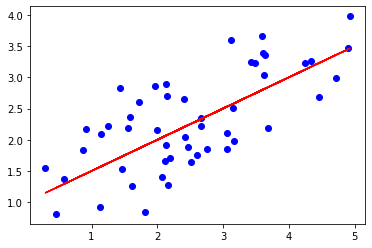

In [13]:
data_plotter(data, true_w0= 1., true_w1=.5)

## Specification of the Pyro model and guide

Here we specify a (Bayesian) linear regression model in Pyro. The 'data' argument is a dictionary covering the data of the predictor and response variable

In [14]:
def lin_reg_model(data):

    w0 = pyro.sample("w0", dist.Normal(0.0, 1000.0))
    w1 = pyro.sample("w1", dist.Normal(0.0, 1000.0))

    with pyro.plate("data_plate"):
        pyro.sample("y", dist.Normal(data["x"] * w1 + w0, 1.0), obs=data["y"])

Here we specify the variational distribution, which is called a guide in Pyro. We make the mean field assumption and assume that the variational distribution factorizes wrt. to 'w0' and 'w1'.

In [15]:
def lin_reg_guide(data):
    w0_mean = pyro.param("w0_mean", torch.tensor(0.0))
    w0_scale = pyro.param("w0_scale", torch.tensor(1.0), constraint=constraints.positive)
    pyro.sample("w0", dist.Normal(w0_mean, w0_scale))
    
    w1_mean = pyro.param("w1_mean", torch.tensor(0.0))
    w1_scale = pyro.param("w1_scale", torch.tensor(1.0), constraint=constraints.positive)
    pyro.sample("w1", dist.Normal(w1_mean, w1_scale))

### Learning

In this function the actual learning is taking place. Notice that the structure is similar to what we saw in the example notebooks during the lecture.

In [16]:
def learn(N=10, data=None, model=lin_reg_model, guide=lin_reg_guide, lr=0.0001, num_steps=5000, verbose=False):
    if data is None:
        data = generate_data(N=N)

    pyro.clear_param_store()

    elbo = pyro.infer.Trace_ELBO()
    svi = pyro.infer.SVI(model=model,
                         guide=guide,
                         optim=SGD({"lr": lr}),
                         loss=elbo)

    for step in range(num_steps):
        loss = svi.step(data)

        if verbose and step % 100 == 0:
            w0_mean = pyro.param("w0_mean").detach().item()
            w0_scale = pyro.param("w0_scale").detach().item()
            w1_mean = pyro.param("w1_mean").detach().item()
            w1_scale = pyro.param("w1_scale").detach().item()
            print(f"Loss (iter: {step}): {loss}")
            print(f"w0: {w0_mean} +/- {w0_scale}\t \t w1: {w1_mean} +/- {w1_scale}")

In [17]:
learn(data=data, verbose=True)

Loss (iter: 0): 166.4325876235962
w0: 0.009411637671291828 +/- 1.0063467025756836	 	 w1: 0.027407420799136162 +/- 0.9975184202194214
Loss (iter: 100): 69.95832973718643
w0: 0.3463050127029419 +/- 0.7539175748825073	 	 w1: 0.8181610703468323 +/- 0.33131396770477295
Loss (iter: 200): 73.70430666208267
w0: 0.3812439441680908 +/- 0.6353329420089722	 	 w1: 0.7096441388130188 +/- 0.23513740301132202
Loss (iter: 300): 75.34987133741379
w0: 0.45738229155540466 +/- 0.5320726633071899	 	 w1: 0.7361891269683838 +/- 0.19359974563121796
Loss (iter: 400): 85.58714193105698
w0: 0.5000043511390686 +/- 0.4613321125507355	 	 w1: 0.6958004236221313 +/- 0.16965745389461517
Loss (iter: 500): 95.87627851963043
w0: 0.5414639115333557 +/- 0.4066067636013031	 	 w1: 0.6550070643424988 +/- 0.15535560250282288
Loss (iter: 600): 75.01702380180359
w0: 0.6072914004325867 +/- 0.3722948729991913	 	 w1: 0.6964654922485352 +/- 0.14532217383384705
Loss (iter: 700): 83.69314920902252
w0: 0.6299824118614197 +/- 0.352505981

### Analyze the results

Here we sample weights from the posterior distributions over 'w0' and 'w1'. The distribution of the generated weights (and the corresponding models) illustrates how confident we are in the model, an insight you cannot get when only having point estimates of the model parameters as found with, e.g., maximum likelihood learning. 

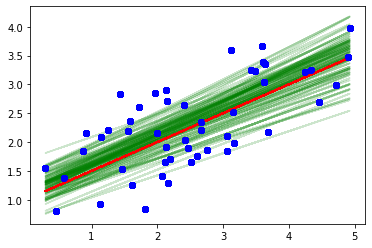

In [18]:
for _ in range(100):
    w0_mean = pyro.param("w0_mean").detach().item()
    w0_scale = pyro.param("w0_scale").detach().item()
    w1_mean = pyro.param("w1_mean").detach().item()
    w1_scale = pyro.param("w1_scale").detach().item()
    w0_sample = pyro.sample("w0_sample", dist.Normal(w0_mean, w0_scale)).numpy()
    w1_sample = pyro.sample("w1_sample", dist.Normal(w1_mean, w1_scale)).numpy()
    data_plotter(data, true_w0= 1., true_w1=.5, approx_w0=w0_sample, approx_w1=w1_sample)
data_plotter(data)
plt.show()

## Exercises:
* Generate data sets of varying sizes and characteristics (by changing the parameters in the 'generate_data' function) and investigate and compare the resulting models.
* Analyze how learning is affected by changing the learning rate and the initial values of the parameters specified in the guide function.
* Experiment with different types of prior knowledge in the model specification (e.g. change the mean and scale of the distributions over the weights). For instance, we may (mostly likely erroneously considering the data) have a prior expectation that 'w0' is around 5.0, and we can encode the strength of this belief through the scale of the corresponding distribution. 

In [19]:
def try_config(N=50, true_w0= 1., true_w1=.5, gamma=4., model=lin_reg_model, guide=lin_reg_guide, lr=0.0001, num_steps=5000):
    data = generate_data(N=N, true_w0= true_w0, true_w1=true_w1, gamma=gamma)
    learn(data=data, model=model, guide=guide, lr=lr, num_steps=num_steps)

    w0_mean = pyro.param("w0_mean").detach().item()
    w0_scale = pyro.param("w0_scale").detach().item()
    w1_mean = pyro.param("w1_mean").detach().item()
    w1_scale = pyro.param("w1_scale").detach().item()

    for _ in range(100):
        w0_sample = pyro.sample("w0_sample", dist.Normal(w0_mean, w0_scale)).numpy()
        w1_sample = pyro.sample("w1_sample", dist.Normal(w1_mean, w1_scale)).numpy()
        data_plotter(data, true_w0=true_w0, true_w1=true_w1, approx_w0=w0_sample, approx_w1=w1_sample)
    
    data_plotter(data)
    plt.show()

    print(f"w0_mean: {w0_mean}, w0_scale: {w0_scale}, w1_mean: {w1_mean}, w1_scale: {w1_scale}")

greater standard deviation

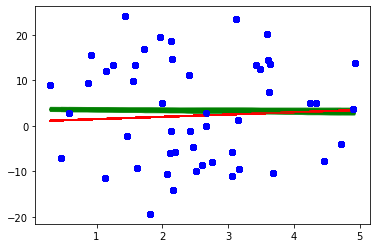

w0_mean: 3.6593425273895264, w0_scale: 0.17705953121185303, w1_mean: -0.12721499800682068, w1_scale: 0.06263438612222672


In [20]:
try_config(gamma=0.01)

smaller standard deviation

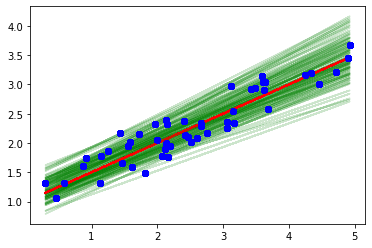

w0_mean: 1.0331135988235474, w0_scale: 0.1784280389547348, w1_mean: 0.47774413228034973, w1_scale: 0.0652710571885109


In [21]:
try_config(gamma=25)

more sampled points

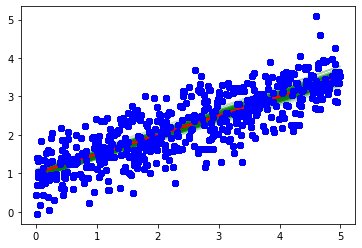

w0_mean: 0.969240128993988, w0_scale: 0.05494382604956627, w1_mean: 0.5043441653251648, w1_scale: 0.019375745207071304


In [22]:
try_config(N=500)

greater standard deviation, more sampled points
(gives the illusion of better estimations; In reality just a change of scale)

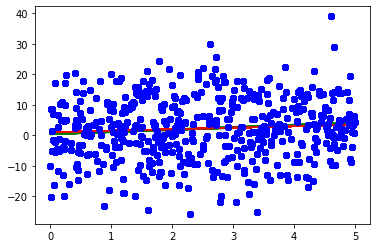

w0_mean: 0.42022204399108887, w0_scale: 0.05488569661974907, w1_mean: 0.7183448672294617, w1_scale: 0.01956094056367874


In [23]:
try_config(N=500, gamma=0.01)

Worse initial prediction of w0 and w1

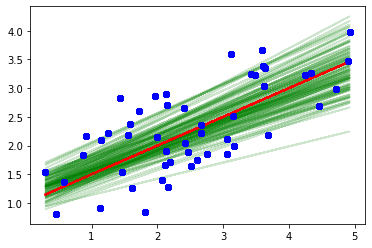

w0_mean: 1.1690548658370972, w0_scale: 0.17858164012432098, w1_mean: 0.43465113639831543, w1_scale: 0.0647769644856453


In [24]:
def lin_reg_guide_worse_pred(data):
    w0_mean = pyro.param("w0_mean", torch.tensor(5.0))
    w0_scale = pyro.param("w0_scale", torch.tensor(5.0), constraint=constraints.positive)
    pyro.sample("w0", dist.Normal(w0_mean, w0_scale))
    
    w1_mean = pyro.param("w1_mean", torch.tensor(5.0))
    w1_scale = pyro.param("w1_scale", torch.tensor(5.0), constraint=constraints.positive)
    pyro.sample("w1", dist.Normal(w1_mean, w1_scale))

try_config(guide=lin_reg_guide_worse_pred)

as above, but greater learning rate and more steps

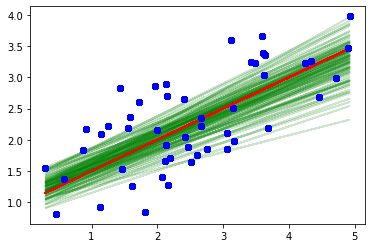

w0_mean: 1.1260709762573242, w0_scale: 0.13920459151268005, w1_mean: 0.4333592653274536, w1_scale: 0.0491037592291832


In [32]:
try_config(guide=lin_reg_guide_worse_pred, lr=0.001, num_steps=10000)

as above, but more sampled points too

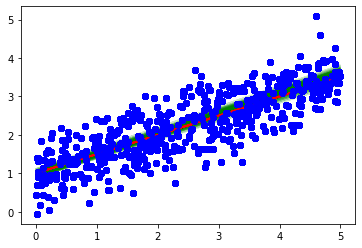

w0_mean: 0.9798887968063354, w0_scale: 0.05728515237569809, w1_mean: 0.5247683525085449, w1_scale: 0.0198713019490242


In [35]:
try_config(guide=lin_reg_guide_worse_pred, N=500)